In [1]:
import numpy as np
import os, sys, librosa
from scipy import signal
from scipy.interpolate import interp1d
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
import IPython.display as ipd
import pandas as pd

sys.path.append('..')
import libfmp.b
import libfmp.c2
import libfmp.c6
%matplotlib inline

### Modelagem do Problema

Existem muitos tipos de música com uma batida forte e estável, onde o tempo é mais ou menos constante durante toda a gravação. Vamos descrever um procedimento de rastreamento de batidas que se baseia nas suposições de que as posições das batidas coincidem com os ataques de nota mais fortes e que o tempo é aproximadamente constante. A ideia principal é construir uma função de pontuação que mede quão bem uma sequência arbitrária de batidas reflete essas duas suposições. A sequência de batidas que maximiza a pontuação constitui o resultado final do rastreamento de batidas. Uma sequência de batidas ótima como essa pode ser computada de maneira eficiente usando programação dinâmica.

A entrada do procedimento de rastreamento de batidas consiste em uma função de novidade $\Delta : [1 : N] \rightarrow \mathbb{R}$, bem como uma estimativa aproximada $\hat{\tau} \in \mathbb{R}_{>0}$ do tempo global. Como de costume, assumimos que o intervalo $[1 : N]$ representa o eixo de tempo amostrado usado para o cálculo da função de novidade. A estimativa de tempo $\hat{\tau}$ pode ser especificada manualmente ou obtida por um procedimento automatizado. A partir de $\hat{\tau}$ e da taxa de amostragem de características, pode-se derivar uma estimativa para o período da batida. Para simplificação, assumimos que o período da batida é especificado em termos de amostras ou índices de características (em vez de em segundos). Seja $\hat{\delta} \in \mathbb{N}$ esse número. Assumindo um tempo aproximadamente constante, a diferença $\delta$ entre duas batidas consecutivas deve ser próxima de $\hat{\delta}$. Para contabilizar o desvio de $\delta$ do período de batida ideal $\hat{\delta}$, introduzimos uma **função de penalidade** $P_{\hat{\delta}} : \mathbb{N} \rightarrow \mathbb{R}$ definida por

$$P_{\hat{\delta}}(\delta) := -\left(\log_2\left(\frac{\delta}{\hat{\delta}}\right)\right)^2$$

para $\delta \in \mathbb{N}$. Essa função tem um valor máximo de zero em $\delta = \hat{\delta}$ e exibe valores negativos cada vez maiores para desvios maiores. Além disso, como as variações de tempo são relativas na natureza (dobrar o tempo deve ser penalizado no mesmo grau que reduzir o tempo pela metade), a função de penalidade é definida para ser simétrica em um eixo logarítmico.

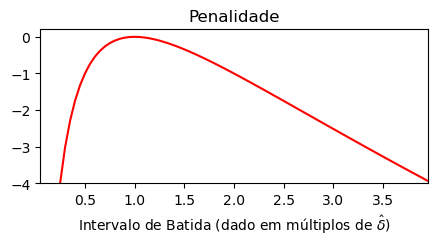

In [2]:
def compute_penalty(N, beat_ref):
    """Calcula a função de penalidade usada para rastreamento de batidas.
    | Nota: A concatenação de '0' é usada por convenções de indexação do Python.
    Args:
        N (int): Comprimento do vetor que representa a função de penalidade.
        beat_ref (int): Período de batida de referência (dado em amostras).    
    Returns:
        penalty (np.ndarray): Função de penalidade."""
    
    # Calcula o eixo t, que é o intervalo de batida em relação ao período de batida de referência
    t = np.arange(1, N) / beat_ref
    
    # Calcula a função de penalidade usando a fórmula logarítmica
    penalty = -np.square(np.log2(t))
    
    # Concatena um zero no início do vetor t e penalty por convenções de indexação do Python
    t = np.concatenate((np.array([0]), t))
    penalty = np.concatenate((np.array([0]), penalty))
    
    return penalty

# Define o período de batida de referência e o comprimento do vetor de penalidade
beat_ref = 20
N = 4 * beat_ref

# Calcula a função de penalidade
penalty = compute_penalty(N, beat_ref)

# Plota a função de penalidade
plt.figure(figsize=(5, 2))
t = np.arange(0, N) / beat_ref
plt.plot(t, penalty, 'r')
plt.ylim([-4, 0.2])
plt.xlim([t[1], t[-1]])
plt.xlabel('Intervalo de Batida (dado em múltiplos de $\hat{\delta}$)')
plt.title('Penalidade')
plt.show()

Para um dado $N \in \mathbb{N}$, seja

$$B = (b_1, b_2, \ldots, b_L)$$

uma sequência de comprimento $L \in \mathbb{N}_0$ que consiste em posições de batidas estritamente crescentes $b_\ell \in [1:N]$ para $\ell \in [1:L]$. No que se segue, referimos a tal sequência como uma sequência de batidas. Por definição, a sequência de batidas de comprimento $L = 0$ é a sequência vazia. Além disso, seja $B^N$ o conjunto de todas as sequências de batidas possíveis para um dado parâmetro $N \in \mathbb{N}$. Para medir a qualidade de uma sequência de batidas $B \in B^N$, introduzimos uma função de pontuação $S(B)$ que inclui valores positivos da função de novidade $\Delta$ e valores negativos da função de penalidade $P_{\hat{\delta}}$. Para isso, definimos

$$S(B) := \sum_{\ell = 1}^L \Delta(b_\ell) + \lambda \sum_{\ell = 2}^L P_{\hat{\delta}}(b_\ell - b_{\ell-1}),$$

onde definimos $S(B) = 0$ para a sequência de batidas vazia com $L = 0$. Além disso, no caso de $L = 1$, obtemos $S(B) = \Delta(b_1)$. Para alcançar uma pontuação alta, os valores de novidade $\Delta(b_\ell)$ devem ser grandes, enquanto os valores de penalidade não positiva $P_{\hat{\delta}}(b_\ell - b_{\ell-1})$ devem ser próximos de zero. O parâmetro de peso $\lambda \in \mathbb{R}_{>0}$ é introduzido para equilibrar essas duas condições conflitantes. A sequência de batidas

$$B^* := \underset{B \in B^N}{\text{argmax}}\{S(B)\}$$

que possui a pontuação máxima entre todas as sequências de batidas possíveis fornece a solução do problema de rastreamento de batidas. A figura a seguir ilustra as definições.

### Algoritmo de Programação Dinâmica

O número de sequências de batidas possíveis é exponencial em $N$. No entanto, é possível calcular uma sequência de batidas ótima de forma eficiente usando **programação dinâmica**. A ideia principal é dividir o problema de otimização em subproblemas mais simples, considerando prefixos. No contexto de rastreamento de batidas, consideramos prefixos da função de novidade subjacente. Mais precisamente, seja $B^n_N \subset B^N$ o conjunto de todas as sequências de batidas que terminam em $n \in [0:N]$. Em outras palavras, para uma sequência de batidas $B = (b_1, b_2, \ldots, b_L) \in B^n_N$, temos $b_L = n$. Note que, no caso $n = 0$, a única sequência de batidas possível é a sequência vazia.

Seja

$$D(n) := \max \{S(B) \ | \ B \in B^n_N\}$$

a pontuação máxima sobre todas as sequências de batidas que terminam em $n \in [0:M]$. O valor $D(n)$ também é conhecido como a pontuação acumulada. Não é difícil ver que

$$S(B^*) = \max_{n \in [0:M]} D(n).$$

Os valores $D(n)$ podem ser calculados de forma iterativa para $n = 0, 1, \ldots, N$. A seguir descrevemos esse procedimento. Graças à programação dinâmica, o número exponencial de operações necessárias para calcular a pontuação de todas as sequências de batidas possíveis é reduzido para um número de operações que é quadrático em $N$.


---
### Algoritmo: Sequência de Batidas Ótima

**Entrada**:
- Função de novidade $\Delta : [1 : N] \rightarrow \mathbb{R}$
- Estimativa $\hat{\delta}$ para o período da batida (dado em amostras)
- Parâmetro de peso $\lambda \in \mathbb{R}$

**Saída**:
- Sequência de batidas ótima $B^* = (b_1, b_2, \ldots, b_L)$

**Procedimento**:
1. Inicialize $D(0) = 0$ e $P(0) = 0$. Então, calcule em um loop para $n = 1, \ldots, N$:

$$D(n) = \Delta(n) + \max \left\{ 0, \max_{m \in [1:n-1]} \{D(m) + \lambda P_{\hat{\delta}}(n - m)\} \right\}$$

Se $D(n) = \Delta(n)$ então defina $P(n) = 0$, caso contrário, defina 

$$P(n) = \underset{m \in [1:n-1]}{\text{argmax}} \{D(m) + \lambda P_{\hat{\delta}}(n - m)\}.$$

2. Defina $\ell = 1$ e $a_\ell = \underset{n \in [0:N]}{\text{argmax}} \ D(n)$. Então repita os seguintes passos até que $P(a_\ell) = 0$:

   - Aumente $\ell$ em um.
   - Defina $a_\ell = P(a_{\ell-1})$.

3. Se $a_\ell = 0$, então defina $L = 0$ e retorne $B^* = \emptyset$.

4. Caso contrário, defina $L = \ell$ e retorne $B^* = (a_L, a_{L-1}, \ldots, a_1)$.

---

### Explicação:

Este algoritmo usa **programação dinâmica** para encontrar a sequência de batidas ótima que maximiza a pontuação baseada na função de novidade $\Delta$ e na função de penalidade $P_{\hat{\delta}}$. A ideia principal é iterativamente construir uma tabela $D(n)$ que contém a pontuação máxima acumulada para cada possível posição de batida $n$. A tabela $P(n)$ é usada para armazenar a posição anterior de onde a batida ótima vem, permitindo reconstruir a sequência de batidas ótima no final. 

- **$D(n)$**: Pontuação acumulada máxima para a batida na posição $n$.
- **$P(n)$**: Índice da batida anterior na sequência ótima que leva a $D(n)$.

In [5]:
def compute_beat_sequence(novelty, beat_ref, penalty=None, factor=1.0, return_all=False):
    """ Calcula a sequência de batidas usando programação dinâmica.
    | Nota: A concatenação de '0' é usada por convenções de indexação do Python.
    Args:
        novelty (np.ndarray): Função de novidade.
        beat_ref (int): Período de batida de referência.
        penalty (np.ndarray): Função de penalidade (valor padrão = None).
        factor (float): Parâmetro de peso para ajustar a penalidade (valor padrão = 1.0).
        return_all (bool): Retornar detalhes (valor padrão = False).
    Returns:
        B (np.ndarray): Sequência de batidas ótima.
        D (np.ndarray): Pontuação acumulada.
        P (np.ndarray): Informação de maximização. """
    N = len(novelty)  # Comprimento da função de novidade
    if penalty is None:
        penalty = compute_penalty(N, beat_ref)  # Calcula a função de penalidade se não fornecida
    penalty = penalty * factor  # Ajusta a penalidade pelo fator de peso
    novelty = np.concatenate((np.array([0]), novelty))  # Concatena '0' para convenções de indexação
    D = np.zeros(N+1)  # Inicializa a pontuação acumulada
    P = np.zeros(N+1, dtype=int)  # Inicializa o vetor de maximização
    D[1] = novelty[1]  # Define o valor inicial da pontuação acumulada
    P[1] = 0  # Define o primeiro valor de maximização como 0

    # Cálculo para frente (forward calculation)
    for n in range(2, N+1):
        m_indices = np.arange(1, n)  # Índices de possíveis batidas anteriores
        scores = D[m_indices] + penalty[n-m_indices]  # Calcula as pontuações considerando a penalidade
        maxium = np.max(scores)  # Encontra a pontuação máxima
        if maxium <= 0:
            D[n] = novelty[n]  # Se a pontuação máxima for menor ou igual a 0, apenas o valor da novidade é usado
            P[n] = 0
        else:
            D[n] = novelty[n] + maxium  # Atualiza a pontuação acumulada
            P[n] = np.argmax(scores) + 1  # Atualiza o índice de maximização

    # Retrocesso (backtracking) para encontrar a sequência de batidas ótima
    B = np.zeros(N, dtype=int)
    k = 0
    B[k] = np.argmax(D)  # Começa pelo índice de maior pontuação acumulada
    while P[B[k]] != 0:
        k = k + 1
        B[k] = P[B[k-1]]  # Acompanha o caminho de volta pelas maximizações
    B = B[0:k+1]
    B = B[::-1]  # Inverte a sequência para ter na ordem correta
    B = B - 1  # Ajusta o índice para corresponder à indexação original

    if return_all:
        return B, D, P  # Retorna todos os detalhes se solicitado
    else:
        return B  # Retorna apenas a sequência de batidas ótima

# Exemplo
nov = np.array([0.1, 0.0, 1.0, 0.0, 1.0, 0.8, 0.0, 0.2, 0.4, 1.0, 0.0])
# Valores de penalidade especificados manualmente (na prática, usa-se a função "compute_penalty")
penalty = np.array([0, -2, -0.2, 1.0, 0.5, -0.1, -1, -1.5, -3, -5, -8])
factor = 1
beat = 3

# Calcula a sequência de batidas ótima usando o algoritmo de programação dinâmica
B, D, P = compute_beat_sequence(nov, beat, penalty=penalty, factor=1, return_all=True)

# Cria um DataFrame para exibir os resultados
df = pd.DataFrame([np.arange(1, len(nov) + 1), nov, D[1:], P[1:]])
df.rename(index={0: 'n', 1: 'Delta(n)', 2: 'D(n)', 3: 'P(n)'}, inplace=True)
df.rename_axis('n', axis='rows')

class Formatter():
    """Classe para converter coluna em formato de linha"""
    def __init__(self):
        self.i = 0
    def formatter(self, s):
        if self.i == 0 or self.i == 3:
            return_s = str(int(s))
        else:
            return_s = str(s)
        self.i += 1
        return return_s
    
ipd.display(ipd.HTML(df.to_html(formatters={i: Formatter().formatter for i in df.columns}, escape=False, header=False)))

print('Sequência de batidas ótima B:', B + 1)

n,1,2,3,4,5,6,7,8,9,10,11
Delta(n),0.1,0.0,1.0,0.0,1.0,0.8,0.0,0.2,0.4,1.0,0.0
D(n),0.1,0.0,1.0,1.1,2.0,2.8,2.1,3.2,4.2,4.3,4.2
P(n),0,0,0,1,2,3,4,5,6,6,8


Sequência de batidas ótima B: [ 3  6 10]


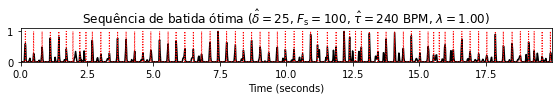

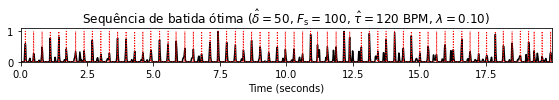

In [27]:
def beat_period_to_tempo(beat, Fs):
    """ Converte o período de batida (amostras) para tempo (BPM) [FMP, Seção 6.3.2]
    Args:
        beat (int): Período de batida (amostras).
        Fs (scalar): Taxa de amostragem.
    Returns:
        tempo (float): Tempo (BPM). """
    # Calcula o tempo em BPM a partir do período de batida em amostras
    tempo = 60 / (beat / Fs)
    return tempo

def compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref, factor, title=None, figsize=(6, 2)):
    """ Calcula, plota e sonifica a sequência de batidas a partir da função de novidade.
    Args:
        x: Sinal de áudio original.
        Fs: Taxa de amostragem do sinal de áudio.
        nov: Função de novidade.
        Fs_nov: Taxa de amostragem da função de novidade.
        beat_ref: Período de batida de referência.
        factor: Parâmetro de peso para ajustar a penalidade.
        title: Título da figura (valor padrão = None).
        figsize: Tamanho da figura (valor padrão = (6, 2))."""
    
    # Calcula a sequência de batidas ótima usando o algoritmo de programação dinâmica
    B = compute_beat_sequence(nov, beat_ref=beat_ref, factor=factor)

    # Inicializa um vetor para armazenar as batidas e marca as posições da sequência de batidas
    beats = np.zeros(len(nov))
    beats[np.array(B, dtype=np.int32)] = 1

    # Se o título não for fornecido, cria um título padrão com informações sobre o tempo e parâmetros
    if title is None:
        tempo = beat_period_to_tempo(beat_ref, Fs_nov)
        title = (r'Sequência de batida ótima ($\hat{\delta}=%d$, $F_\mathrm{s}=%d$, '
                 r'$\hat{\tau}=%0.0f$ BPM, $\lambda=%0.2f$)' % (beat_ref, Fs_nov, tempo, factor))

    # Plota a função de novidade e sobrepõe a sequência de batidas
    fig, ax, line = libfmp.b.plot_signal(nov, Fs_nov, color='k', title=title, figsize=figsize)
    T_coef = np.arange(nov.shape[0]) / Fs_nov
    ax.plot(T_coef, beats, ':r', linewidth=1)
    plt.show()

    # Calcula os tempos em segundos para a sonificação dos picos de batida
    beats_sec = T_coef[B]
    x_peaks = librosa.clicks(times=beats_sec, sr=Fs, click_freq=1000, length=len(x))
    
    # Reproduz o áudio original sobreposto com os cliques nos tempos de batida detectados
    ipd.display(ipd.Audio(x + x_peaks, rate=Fs))

# Carrega o arquivo de áudio
fn_wav = os.path.join('Audios','Luv(sic)_Part_3.mp3')
Fs = 22050
x, Fs = librosa.load(fn_wav) 
x = x[Fs*40:Fs*60]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10, norm=True)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=25, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=50, factor=0.1, figsize=(8, 1.5))

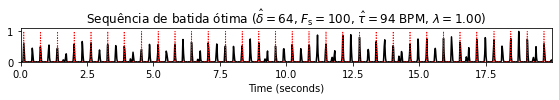

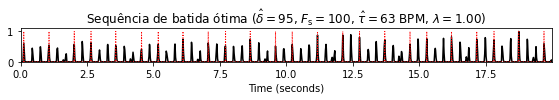

In [77]:
# Carrega o arquivo de áudio
fn_wav = os.path.join('Audios','Luv(sic)_Part_3_(Instrumental).mp3')
Fs = 22050
x, Fs = librosa.load(fn_wav) 
x = x[Fs*40:Fs*60]

nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=2048, H=512, gamma=100, M=10)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=64, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=95, factor=1, figsize=(8, 1.5))

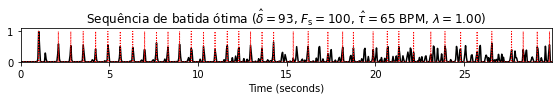

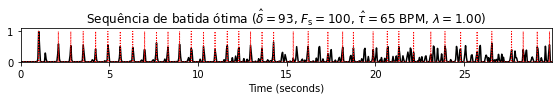

In [78]:
fn_wav = os.path.join('Audios', 'Cartola-Alvorada.mp3')
x, Fs = librosa.load(fn_wav)
x = x[:Fs*30]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_energy(x, Fs=Fs, N=4096, H=1024, gamma=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=93, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=93, factor=1, figsize=(8, 1.5))

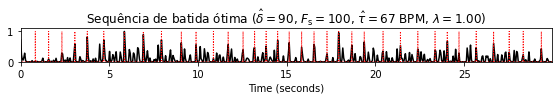

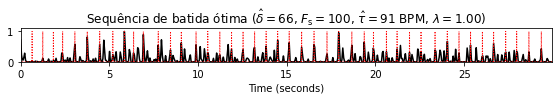

In [88]:
fn_wav = os.path.join('Audios', 'Chico_Buarque-Cotidiano.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs * 10:Fs * 40]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_energy(x, Fs=Fs, N=4096, H=1024, gamma=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=90, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=66, factor=1, figsize=(8, 1.5))

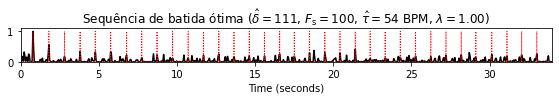

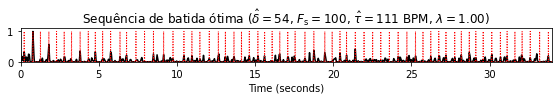

In [95]:
fn_wav = os.path.join('Audios', 'Hermeto_Pascoal-Tacho.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs * 80:Fs * 114]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_energy(x, Fs=Fs, N=4096, H=1024, gamma=100)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=111, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=54, factor=1, figsize=(8, 1.5))

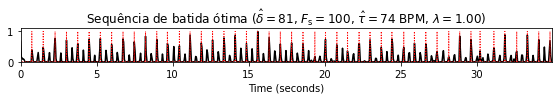

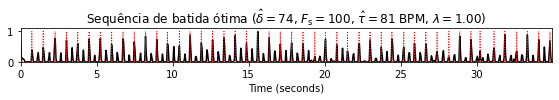

In [98]:
fn_wav = os.path.join('Audios', 'Led_zeppelin-Kashmir.mp3')
x, Fs = librosa.load(fn_wav)
x = x[:Fs*35]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=4096, H=1024, gamma=100)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=81, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=74, factor=1, figsize=(8, 1.5))

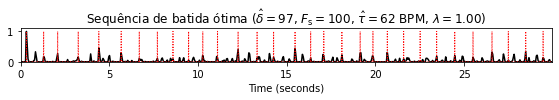

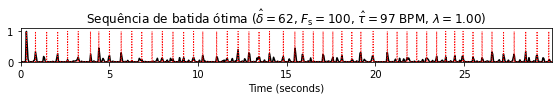

In [104]:
fn_wav = os.path.join('Audios', 'Leo_Brouwer-Un_Día_de_Noviembre.mp3')
x, Fs = librosa.load(fn_wav)
x = x[:Fs*30]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_energy(x, Fs=Fs, N=4096, H=1024, gamma=100)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=97, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=62, factor=1, figsize=(8, 1.5))

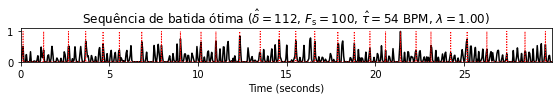

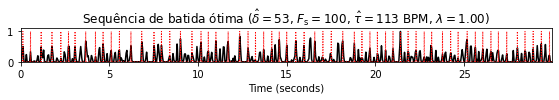

In [111]:
fn_wav = os.path.join('Audios', 'Miles_Davis-Oleo.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs *34:Fs * 64]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_energy(x, Fs=Fs, N=4096, H=1024, gamma=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=112, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=53, factor=1, figsize=(8, 1.5))

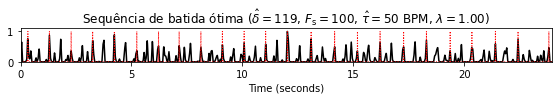

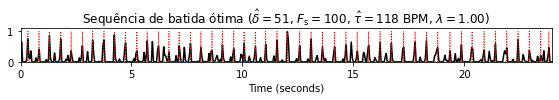

In [114]:
fn_wav = os.path.join('Audios', 'Milton_Nascimento-Cravo_e_Canela.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs *31:Fs * 55]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=4096, H=1024, gamma=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=119, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=51, factor=1, figsize=(8, 1.5))

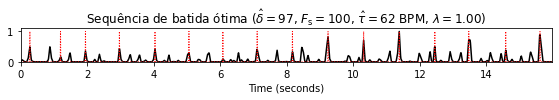

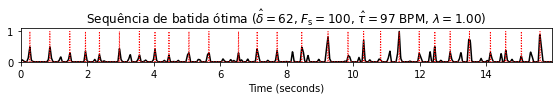

In [119]:
fn_wav = os.path.join('Audios', 'RHCP-Ethiopia.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs*4:Fs*20]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=4096, H=1024, gamma=100)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=97, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=62, factor=1, figsize=(8, 1.5))

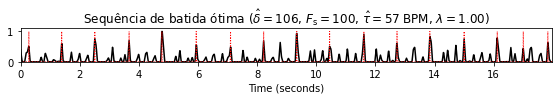

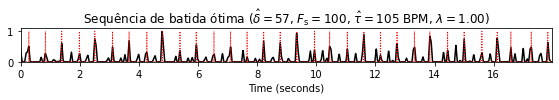

In [124]:
fn_wav = os.path.join('Audios', 'RHCP-The_Adventures_Of_Rain_Dance_Maggie.mp3')
x, Fs = librosa.load(fn_wav)
x = x[Fs*30:Fs*48]

# Calcula o espectro de novidade e o reamostra
nov, Fs_nov = libfmp.c6.compute_novelty_spectrum(x, Fs=Fs, N=4096, H=1024, gamma=1)
nov, Fs_nov = libfmp.c6.resample_signal(nov, Fs_in=Fs_nov, Fs_out=100)

# Calcula, plota e sonifica a sequência de batidas para diferentes parâmetros de referência
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=106, factor=1, figsize=(8, 1.5))
compute_plot_sonify_beat(x, Fs, nov, Fs_nov, beat_ref=57, factor=1, figsize=(8, 1.5))